In [1]:
!nvidia-smi

Sun Mar  2 13:42:56 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   51C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics 8.3.82 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 35.5/112.6 GB disk)


In [3]:
from ultralytics import YOLO

from IPython.display import display, Image

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
!unzip '/content/drive/MyDrive/AFO_YOLO11.zip' -d '/content/AFO'

Streaming output truncated to the last 5000 lines.
  inflating: /content/AFO/train/images/r3_216.jpg  
  inflating: /content/AFO/train/images/r3_217.jpg  
  inflating: /content/AFO/train/images/r3_218.jpg  
  inflating: /content/AFO/train/images/r3_219.jpg  
  inflating: /content/AFO/train/images/r3_22.jpg  
  inflating: /content/AFO/train/images/r3_220.jpg  
  inflating: /content/AFO/train/images/r3_221.jpg  
  inflating: /content/AFO/train/images/r3_222.jpg  
  inflating: /content/AFO/train/images/r3_224.jpg  
  inflating: /content/AFO/train/images/r3_226.jpg  
  inflating: /content/AFO/train/images/r3_23.jpg  
  inflating: /content/AFO/train/images/r3_235.jpg  
  inflating: /content/AFO/train/images/r3_236.jpg  
  inflating: /content/AFO/train/images/r3_237.jpg  
  inflating: /content/AFO/train/images/r3_238.jpg  
  inflating: /content/AFO/train/images/r3_24.jpg  
  inflating: /content/AFO/train/images/r3_240.jpg  
  inflating: /content/AFO/train/images/r3_241.jpg  
  inflating: /co

In [19]:
# Install the required packages for Ultralytics YOLO and Weights & Biases
!pip install -U ultralytics wandb

# Enable W&B logging for Ultralytics
!yolo settings wandb=True

JSONDict("/root/.config/Ultralytics/settings.json"):
{
  "settings_version": "0.0.6",
  "datasets_dir": "/content/datasets",
  "weights_dir": "weights",
  "runs_dir": "runs",
  "uuid": "569f3ba64b326db489132663f79cd37279811de477381b83ac131e6cdd129cbb",
  "sync": true,
  "api_key": "",
  "openai_api_key": "",
  "clearml": true,
  "comet": true,
  "dvc": true,
  "hub": true,
  "mlflow": true,
  "neptune": true,
  "raytune": true,
  "tensorboard": true,
  "wandb": true,
  "vscode_msg": true
}
💡 Learn more about Ultralytics Settings at https://docs.ultralytics.com/quickstart/#ultralytics-settings


In [20]:
import wandb

# Initialize your Weights & Biases environment
wandb.login(key="707c7f73c01be1b48566ff60a7c5cd099ca09af2")

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: ultraluxe25 (kaggle-contributor) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [21]:
%%time
!yolo task=detect mode=train model=yolo11s.pt data='/content/AFO/data.yaml' epochs=25 imgsz=640 plots=True

100% 18.4M/18.4M [00:00<00:00, 156MB/s]
Ultralytics 8.3.82 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/AFO/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_la

In [7]:
import os

HOME = os.getcwd()
print(HOME)

/content


In [22]:
!ls {HOME}/runs/detect/train2/

args.yaml					     R_curve.png	  val_batch0_labels.jpg
confusion_matrix_normalized.png			     results.csv	  val_batch0_pred.jpg
confusion_matrix.png				     results.png	  val_batch1_labels.jpg
events.out.tfevents.1740926622.d52bfbafbd17.16426.0  train_batch0.jpg	  val_batch1_pred.jpg
F1_curve.png					     train_batch1.jpg	  val_batch2_labels.jpg
labels_correlogram.jpg				     train_batch2595.jpg  val_batch2_pred.jpg
labels.jpg					     train_batch2596.jpg  weights
P_curve.png					     train_batch2597.jpg
PR_curve.png					     train_batch2.jpg


/content


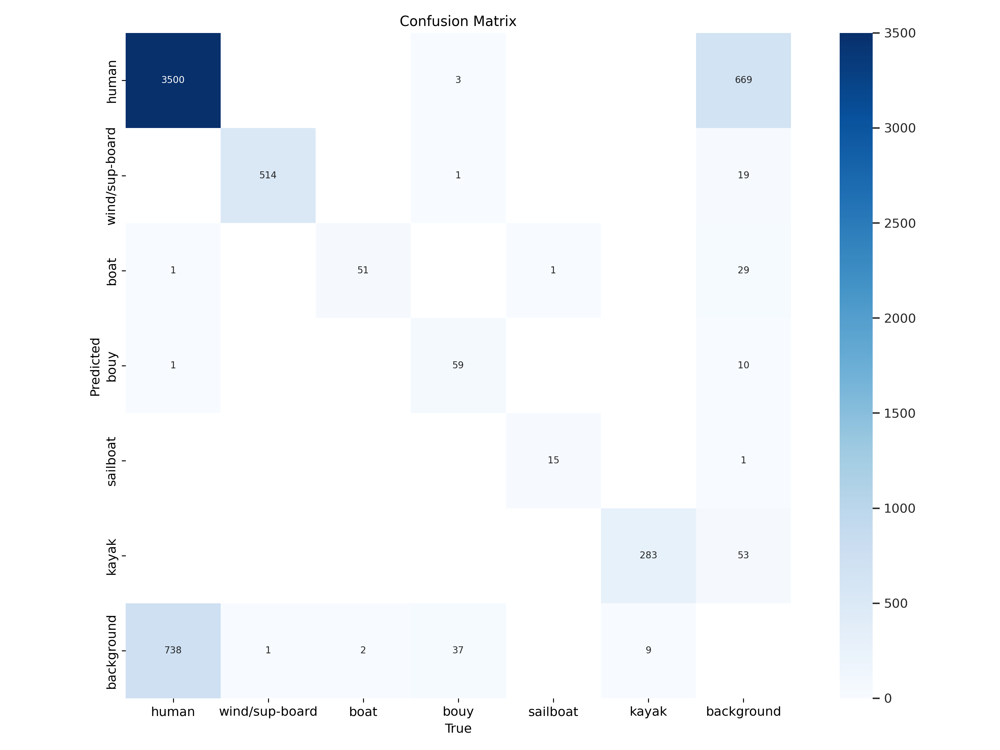

In [23]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/confusion_matrix.png', width=600)

/content


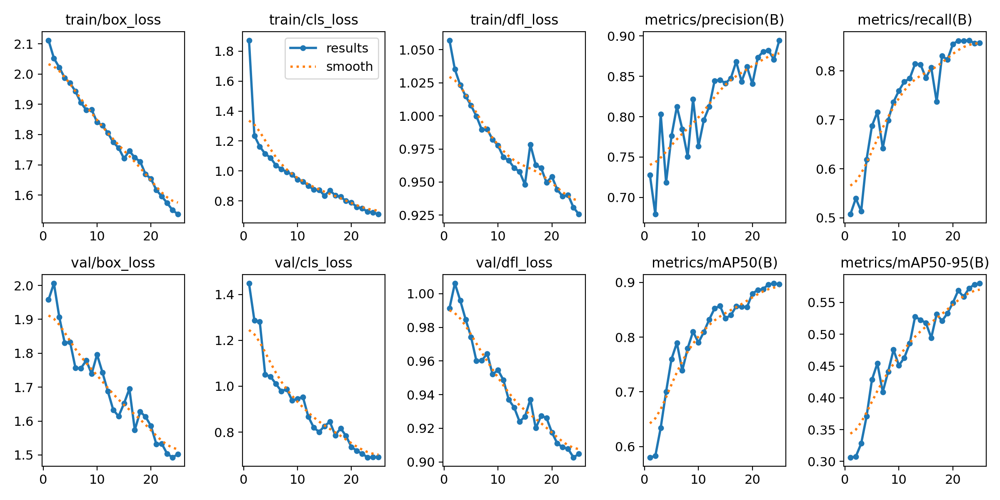

In [24]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/results.png', width=600)

/content


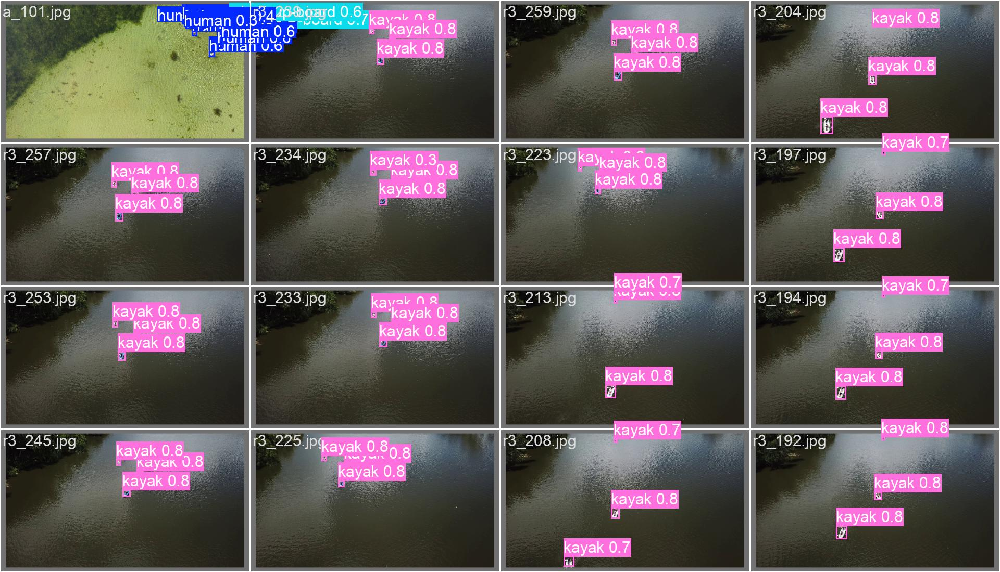

In [25]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width=600)

/content


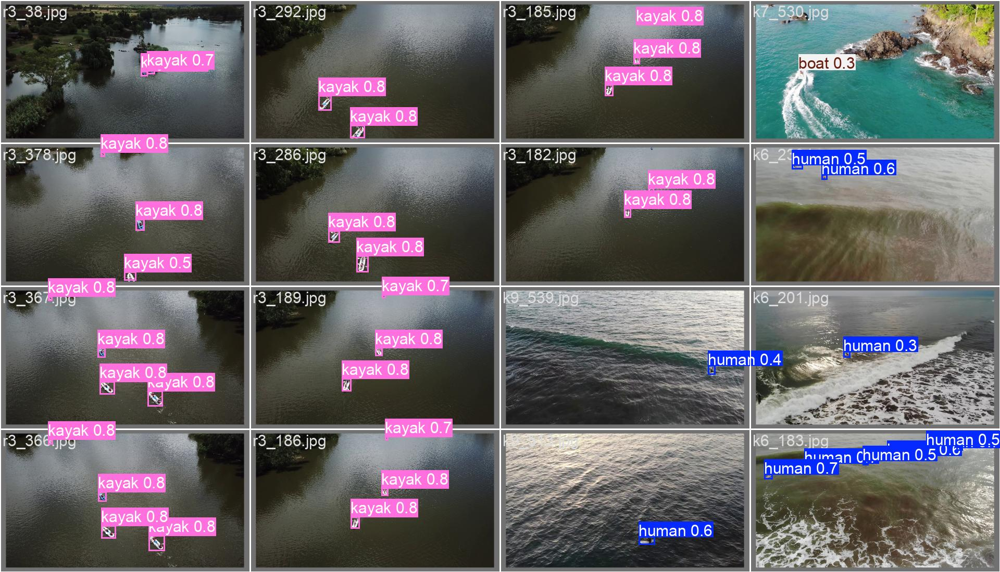

In [26]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/val_batch1_pred.jpg', width=600)

## Validate Custom Model

In [27]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train2/weights/best.pt data='/content/AFO/data.yaml'

/content
Ultralytics 8.3.82 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,415,122 parameters, 0 gradients, 21.3 GFLOPs
val: Scanning /content/AFO/valid/labels.cache... 339 images, 8 backgrounds, 5 corrupt: 100% 339/339 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/AFO/valid/images/a_1116.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0003]
val: WARNING ⚠️ /content/AFO/valid/images/a_1258.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
val: WARNING ⚠️ /content/AFO/valid/images/d_366.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0167      1.0014]
val: WARNING ⚠️ /content/AFO/valid/images/d_436.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0144]
val: WARNING ⚠️ /content/AFO/valid/images/e_22.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   

## Inference with Custom Model

In [28]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.5 source='/content/AFO/test/images' save=True

/content
Ultralytics 8.3.82 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,415,122 parameters, 0 gradients, 21.3 GFLOPs

image 1/515 /content/AFO/test/images/a_301.jpg: 384x640 20 humans, 5 wind/sup-boards, 45.8ms
image 2/515 /content/AFO/test/images/a_302.jpg: 384x640 22 humans, 5 wind/sup-boards, 10.9ms
image 3/515 /content/AFO/test/images/a_303.jpg: 384x640 20 humans, 6 wind/sup-boards, 10.9ms
image 4/515 /content/AFO/test/images/a_304.jpg: 384x640 18 humans, 5 wind/sup-boards, 10.9ms
image 5/515 /content/AFO/test/images/a_305.jpg: 384x640 19 humans, 6 wind/sup-boards, 10.8ms
image 6/515 /content/AFO/test/images/a_306.jpg: 384x640 18 humans, 4 wind/sup-boards, 10.9ms
image 7/515 /content/AFO/test/images/a_307.jpg: 384x640 20 humans, 4 wind/sup-boards, 10.9ms
image 8/515 /content/AFO/test/images/a_308.jpg: 384x640 19 humans, 4 wind/sup-boards, 10.9ms
image 9/515 /content/AFO/test/images/a_309.jpg: 384x640 16 humans, 4 wind/sup-bo

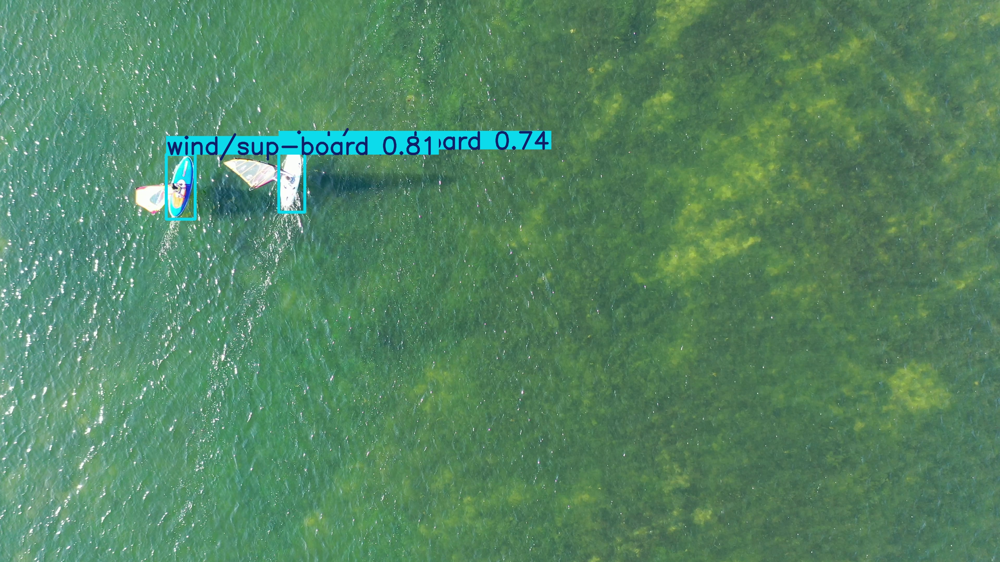

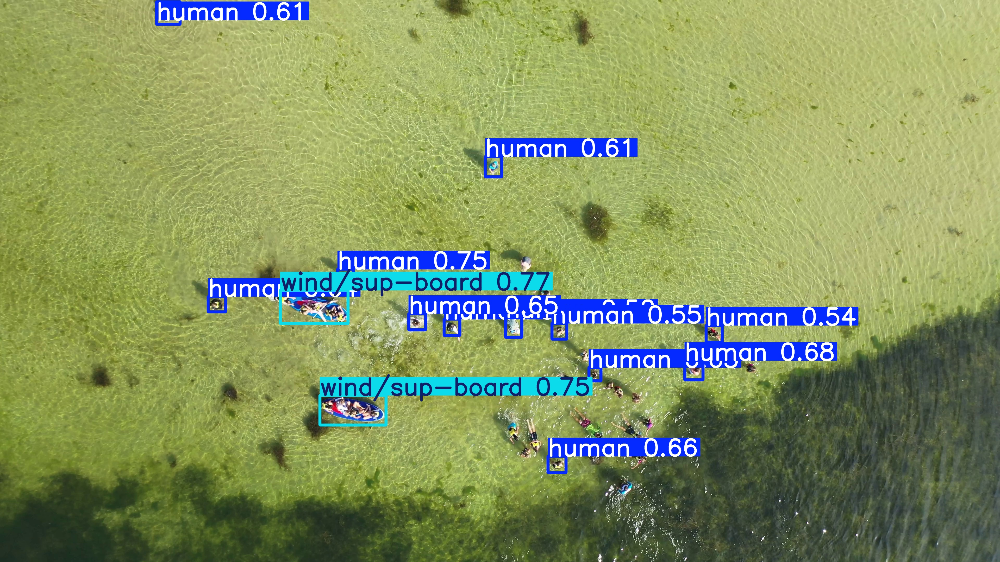

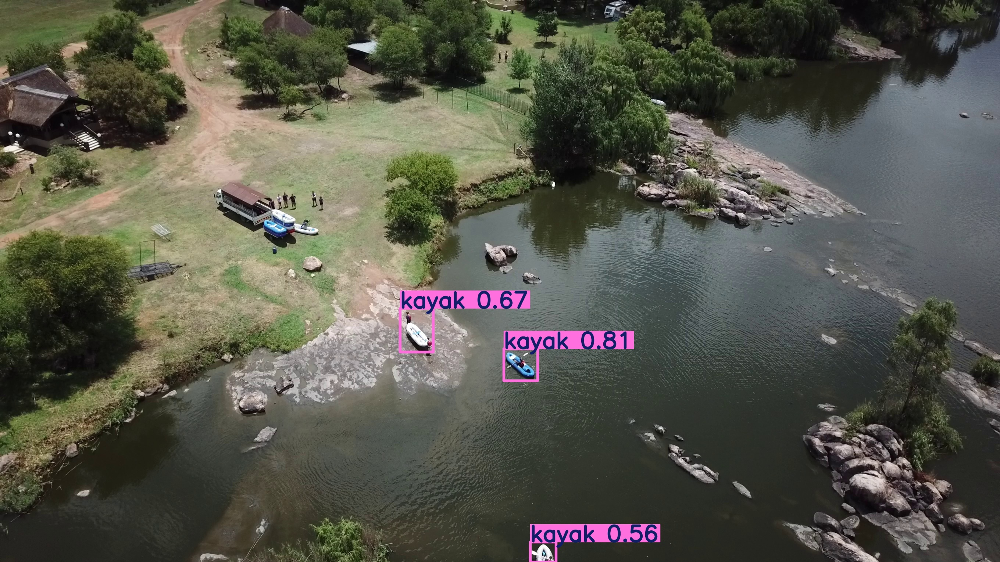

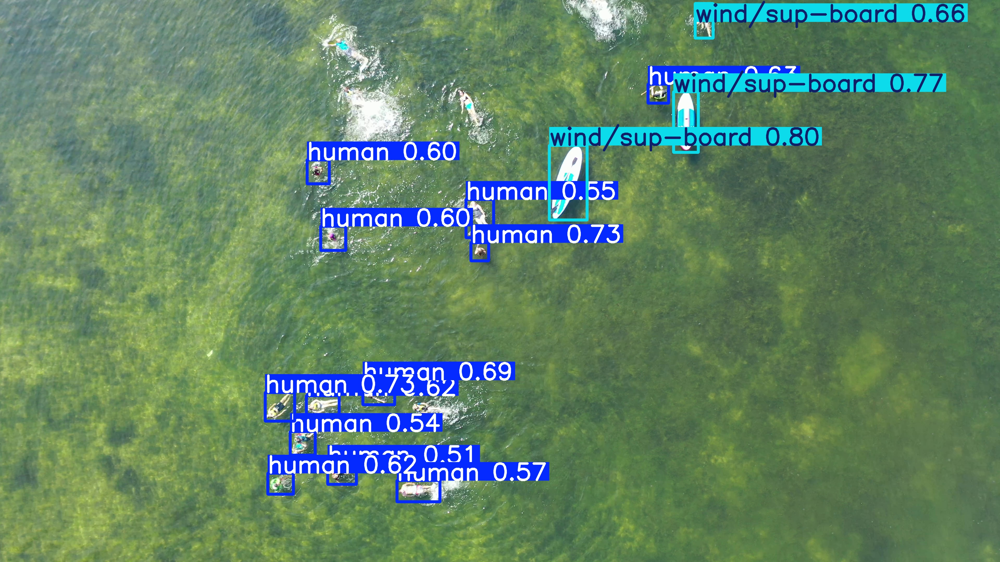

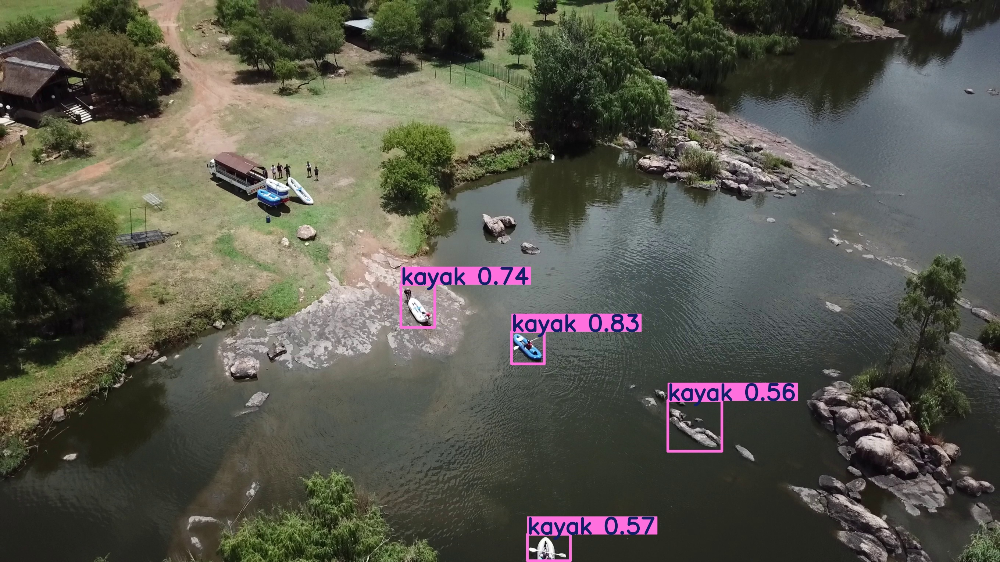

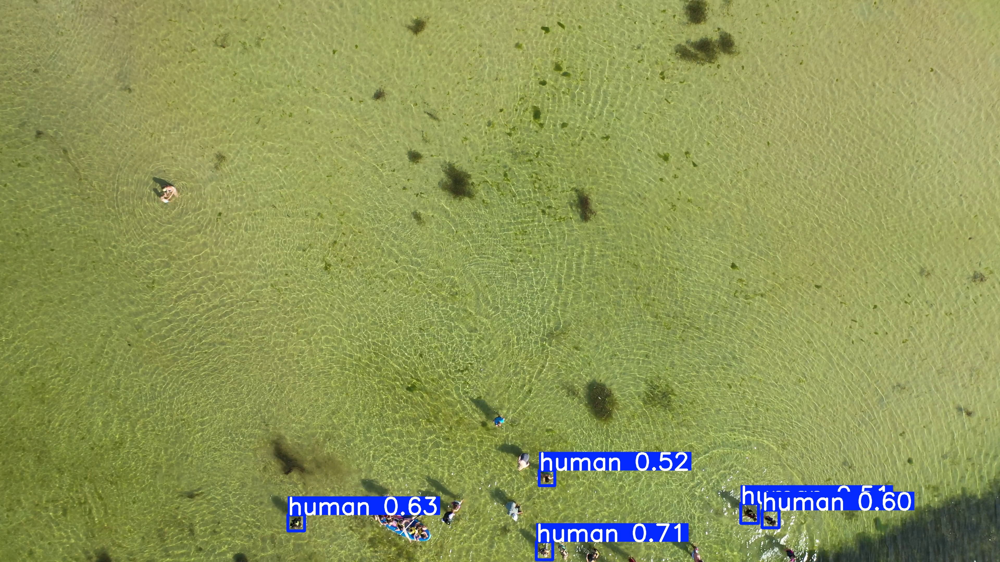

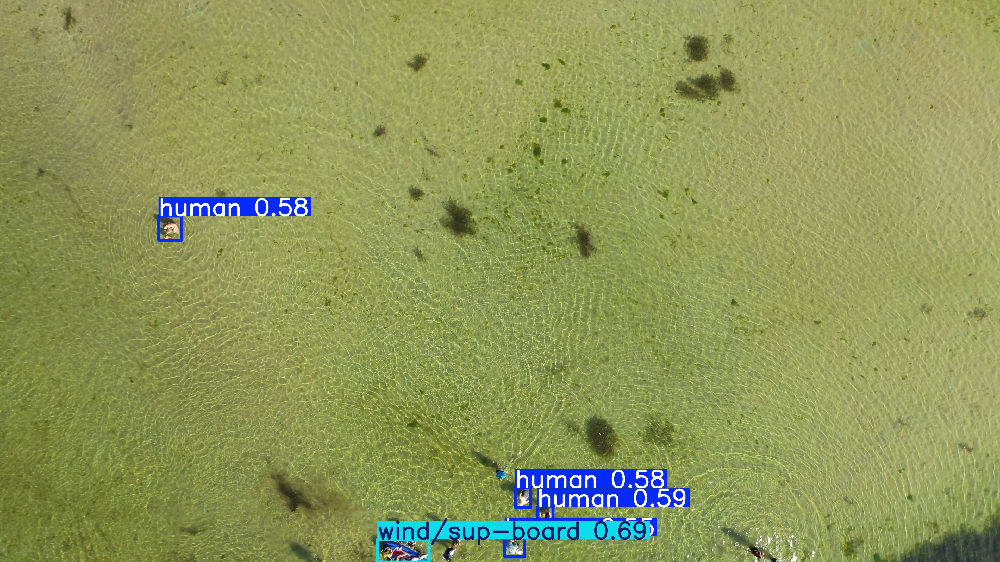

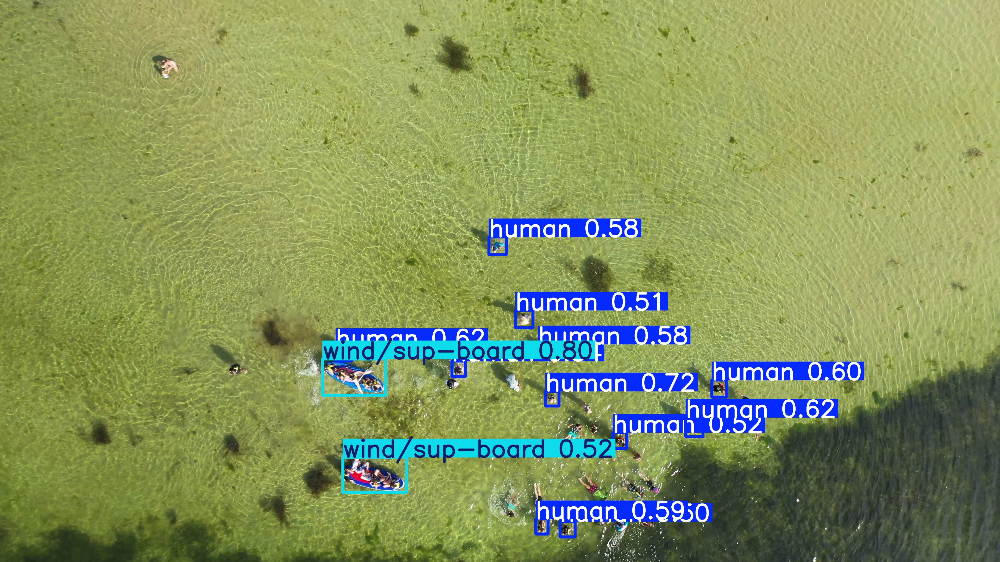

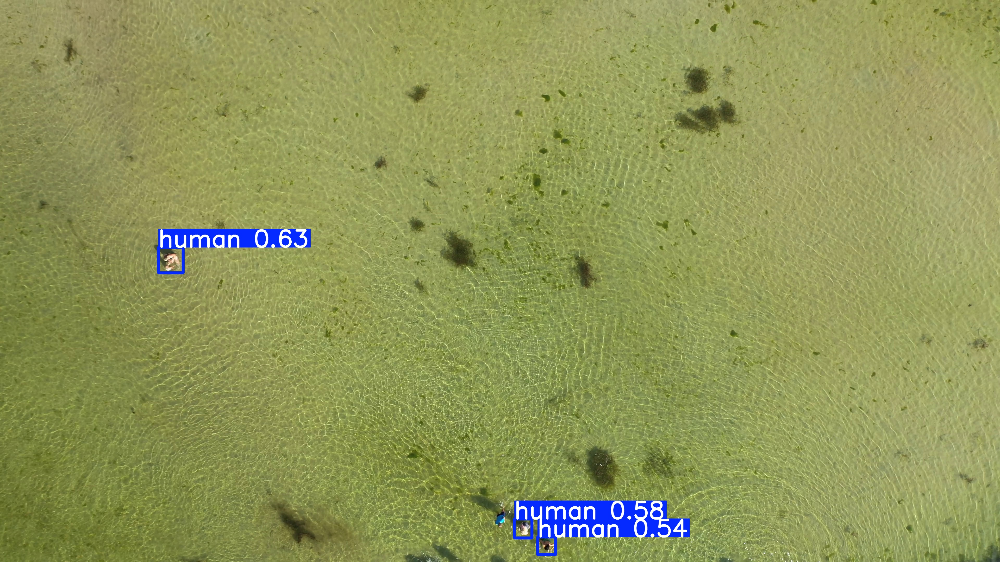

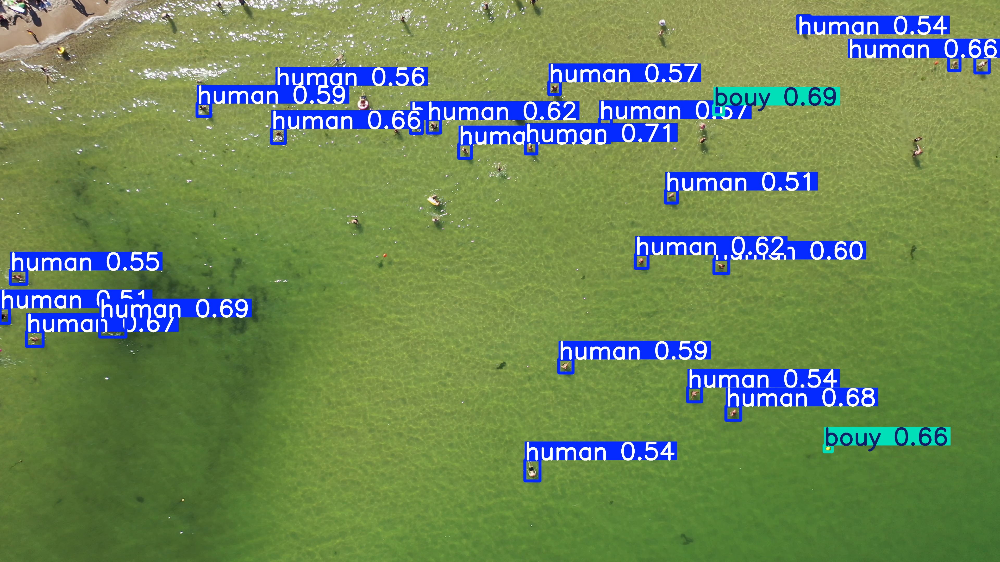

In [29]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict2/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

In [30]:
import shutil

folder_path = "/content/runs/detect/train"

# Permanent archive
shutil.make_archive("/content/train_archive", 'zip', folder_path)

from google.colab import files
files.download("/content/train_archive.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [31]:
folder_path = "/content/runs/detect/predict"

# Permanent archive
shutil.make_archive("/content/runs/detect/predict", 'zip', folder_path)

files.download("/content/runs/detect/predict.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>